In [1]:
import pandas as pd
import geopandas as gpd
import altair as alt
from shapely.geometry import Point, Polygon, linestring, shape, mapping
from geopy.geocoders import GoogleV3

/Users/shelbyjouppi/.pyenv/versions/3.9.7/lib/python3.9/site-packages/pandas/compat/__init__.py:124: UserWarning: Could not import the lzma module. Your installed Python is incomplete. Attempting to use lzma compression will result in a RuntimeError.
  warnings.warn(msg)


# Importing Clinic Data

Source: Summer 2022 survey of Article 31 Community Clinics

In [2]:
# Reading the data
nycClinics = pd.read_csv('data/nyc-article31-childadolescent-survey-081022.csv')

# Cleaning Columns + Creating new ones
nycClinics.site_zip_code = nycClinics.site_zip_code.astype('str').str[:5]
nycClinics.new_patients = nycClinics.new_patients.str.lower()
nycClinics['months_mean'] = nycClinics['weeks_mean'] / 4.345

# School & Community Clinics Separately
schoolClinics = nycClinics.query('type=="School"')
nycClinics = nycClinics.query('type=="Community"')



display(nycClinics.head(2))
nycClinics.shape

,agency_name,site_name,specialty,specialty_desc,nokids_notherapy,nokids_notherapy_desc,not_applicable,not_applicable_desc,site_city,site_zip_code,...,wait_time,weeks_low,weeks_high,weeks_mean,months_low,months_high,lat,long,geometry,months_mean
0,Beth Israel Medical Center,Beth Israel Medical Center Child Outpatient De...,NaN,NaN,NaN,NaN,NaN,NaN,New York,10003,...,End of July,7.0,7.0,7.0,1.75,1.75,40.733089,-73.983039,"[-73.9830393, 40.73308919999999]",1.611047
1,NYC-HHC Bellevue Hospital Center,Bellevue Hospital Center Child & Adolescent Cl...,NaN,NaN,NaN,NaN,NaN,NaN,New York,10016,...,no list,NaN,NaN,NaN,NaN,NaN,40.739726,-73.976201,"[-73.976201, 40.7397258]",NaN


(225, 28)

In [3]:
# Making GeoDataFrames
nycClinics = gpd.GeoDataFrame(
    nycClinics, geometry=gpd.points_from_xy(x=nycClinics.long, y=nycClinics.lat)
 )

# Assigning CRS
nycClinics = nycClinics.set_crs('EPSG:4326')

### Reading in the Medicaid enrollment GeoJSON files

<AxesSubplot:>

(263, 14)

<AxesSubplot:>

(42, 9)

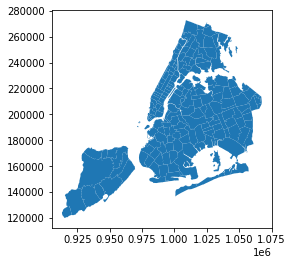

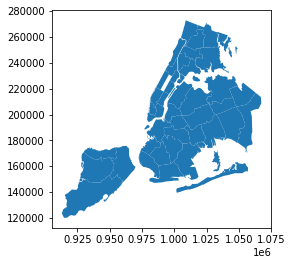

In [4]:
# Zip code level file
medicaidZip = gpd.read_file("data/nycEnrollmentZip.geojson")
display(medicaidZip.plot())
display(medicaidZip.shape)

# UHF level file
medicaidUHF = gpd.read_file("data/nycEnrollmentUHF.geojson")
display(medicaidUHF.plot())
display(medicaidUHF.shape)

In [5]:
# Assigning CRS
medicaidZip = medicaidZip.to_crs('EPSG:4326')
medicaidUHF = medicaidUHF.to_crs('EPSG:4326')

### Map Enrollment by Neighborhood

In [6]:
medicaidUHFMap = alt.Chart(medicaidUHF).mark_geoshape().encode(
    color='AGE_5-18:Q',
    tooltip=['UHF_NEIGH:N', 'AGE_5-18:Q']
).properties(
    width=400,
    height=400,
)

medicaidUHFMap

alt.Chart(...)

### Mapping Enrollment by Zip

In [7]:

medicaidZipMap = alt.Chart(medicaidZip).mark_geoshape().encode(
    color=alt.Color('AGE_5-18:Q',
    scale=alt.Scale(scheme="purpleblue")),
    tooltip=['ZIPCODE:N', 'AGE_5-18:Q']
).properties(
    width=400,
    height=400,
)
medicaidZipMap

alt.Chart(...)

In [11]:
nycClinics.weeks_mean

0       7.00
1        NaN
2       8.00
3       1.50
4        NaN
       ...  
436      NaN
449      NaN
451      NaN
473      NaN
477    15.21
Name: weeks_mean, Length: 225, dtype: float64

### Mapping clinic wait times against enrollment

In [8]:
medicaidZipMapLarge = alt.Chart(medicaidZip).mark_geoshape().encode(
    color=alt.Color('AGE_5-18:Q',
      legend=alt.Legend(title='Medicaid Enrollees Age 5-18',format='.0f'),
      scale=alt.Scale(scheme='purpleblue')),
    tooltip=['ZIPCODE:N', 'AGE_5-18:Q']
).properties(
    width=600,
    height=600,
    title='Clinic Wait Times and Child Medicaid Enrollment'
)

# Survey Results ----- 

# No new patient Clinics 
noNewclinicMap = alt.Chart(nycClinics.query('new_patients == "no"')).mark_circle(
    stroke='black',
    strokeWidth=1,
    size=60,
     opacity=1
).encode(
    latitude='lat:Q',
    longitude='long:Q',
    color=alt.value('#ecb92d'),
    tooltip = alt.Tooltip(['agency_name','site_name','new_patients']))

# Open Clinics
yesNewclinicMap = alt.Chart(nycClinics.query('new_patients == "yes"')).mark_circle(
    stroke='black',
    strokeWidth=1
    ).encode(
    latitude='lat:Q',
    longitude='long:Q',
    color=alt.value('white'),
    size='weeks_mean:Q',
    tooltip = alt.Tooltip(['agency_name','site_name','weeks_mean']))

# Missing Clinics
missingClinicMap = alt.Chart(nycClinics.query('new_patients.isnull() and nokids_notherapy !="Y" and not_applicable !="Y"')).mark_circle().encode(
    latitude='lat:Q',
    longitude='long:Q',
    color=alt.value('grey'),
    tooltip = alt.Tooltip(['agency_name','site_name']))

# No Kids or Therapy or Closed
otherClosedMap = alt.Chart(nycClinics.query('nokids_notherapy == "Y"')).mark_circle(
    stroke='black',
    strokeWidth=1,
    size=60,
    opacity=1
).encode(
    latitude='lat:Q',
    longitude='long:Q',
    color=alt.value('#ecb92d'),
    tooltip = alt.Tooltip(['agency_name','site_name']))

In [9]:
medicaidZipMapLarge + otherClosedMap  + noNewclinicMap +yesNewclinicMap

alt.LayerChart(...)

In [27]:
# dropping this becasue something is weird with the geometry:
schoolClinics = schoolClinics.query('site_name != "PS 197 - The Ocean School"')

In [31]:
schoolclinicMap = alt.Chart(schoolClinics).mark_circle(
    stroke='black',
    strokeWidth=1,
    size=20
).encode(
    latitude='lat:Q',
    longitude='long:Q',
    color=alt.value('orange'),
    tooltip = alt.Tooltip(['agency_name','site_name'])).properties(
    title='School Article 31 Clinics'
)

communityclinicMap = alt.Chart(nycClinics).mark_circle(
    stroke='black',
    strokeWidth=1,
    size=20
).encode(
    latitude='lat:Q',
    longitude='long:Q',
    color=alt.value('white')).properties(
    title='Community Article 31 Clinics'
)
    
    
medicaidZipMap + schoolclinicMap | medicaidZipMap + communityclinicMap

alt.HConcatChart(...)

In [32]:
yesNewclinicMap = alt.Chart(nycClinics.query('new_patients == "yes"')).mark_circle(
    stroke='black',
    strokeWidth=1,
    ).encode(
    latitude='lat:Q',
    longitude='long:Q',
    color=alt.value('white'),
    size='weeks_mean:Q',
    tooltip = alt.Tooltip(['agency_name','site_name','weeks_mean']))

In [33]:
medicaidZipMap = alt.Chart(medicaidZip).mark_geoshape().encode(
    color=alt.Color('AGE_5-18:Q',
    scale=alt.Scale(scheme="greenblue")),
    tooltip=['ZIPCODE:N', 'AGE_5-18:Q']
).properties(
    width=400,
    height=400,
)

In [34]:
medicaidZipMap + noNewclinicMap + otherClosedMap | medicaidZipMap + yesNewclinicMap

alt.HConcatChart(...)

In [35]:
surveyedClinicMap = alt.Chart(nycClinics.query('new_patients.notnull() or nokids_notherapy.notnull()')).mark_circle(
    stroke='black',
    strokeWidth=1,
    size=60
    ).encode(
    latitude='lat:Q',
    longitude='long:Q',
    color=alt.value('white'),
#     size='weeks_mean:Q',
    tooltip = alt.Tooltip(['agency_name','site_name','weeks_mean']))

missingClinicMap = alt.Chart(nycClinics.query('new_patients.isnull() and nokids_notherapy !="Y" and not_applicable !="Y"')).mark_circle(
    stroke='black',
    strokeWidth=1,
    size=60
).encode(
    latitude='lat:Q',
    longitude='long:Q',
    color=alt.value('#db5540'),
    tooltip = alt.Tooltip(['agency_name','site_name']))


In [36]:
medicaidUHFAlt = alt.Chart(medicaidUHF).mark_geoshape(
strokeWidth=.2,
opacity=.9,
stroke='black').encode(
    color=alt.value('#EFEFEF'),
    tooltip=['ZIPCODE:N', 'AGE_5-18:Q']
).properties(
    width=400,
    height=400,
)

In [37]:
medicaidZipMap + surveyedClinicMap | medicaidZipMap + missingClinicMap

alt.HConcatChart(...)

# Analysis

#### What was the median average wait time by county?

In [38]:
nycClinics.groupby('site_county').weeks_mean.median()

site_county
Bronx        8.095
Kings        4.350
New York     7.000
Queens       7.675
Richmond    12.095
Name: weeks_mean, dtype: float64

#### What was the median average wait time citywide?

In [39]:
nycClinics.weeks_mean.median()

7.0

### Survey Results Breakdown

In [40]:
# Closed to kids for some reason
totalElse = nycClinics.query('nokids_notherapy == "Y"').site_name.nunique()

# Yes to new child patients
totalYes = nycClinics.query('new_patients == "yes"').site_name.nunique()

# No to new child patients
totalNo = nycClinics.query('new_patients == "no"').site_name.nunique()


total = totalYes + totalNo + totalElse
pctNo = totalNo / total
pctYes = totalYes / total

#### Are accepting new patients vs. NOT accepting new patients?

In [41]:
print(f"{totalYes} clinics ARE accepting new patients")
print(f"{totalNo} clinics are NOT accepting new patients")
print("----")
print(f"{pctNo}% of clinics are NOT accepting new patients")

113 clinics ARE accepting new patients
45 clinics are NOT accepting new patients
----
0.2616279069767442% of clinics are NOT accepting new patients


#### % of clinics with wait times 6 weeks or more

In [42]:
wait6wks = nycClinics.query('new_patients == "yes" and months_mean > 1.49').site_name.nunique()
pct6wks = wait6wks/totalYes

print(f"{wait6wks} clinics with wait times 6 weeks or more")
print(f"{pct6wks}% of all open clinics")

60 clinics with wait times 6 weeks or more
0.5309734513274337% of all open clinics


#### % of clinics with wait times 2 months or more

In [43]:
# Pct of clinics with wait times two months or more
wait2mo = nycClinics.query('new_patients == "yes" and months_mean > 1.99').site_name.nunique()
pct2mo = wait2mo / totalYes


print(f"{wait2mo} clinics with wait times 2 months or more")
print(f"{pct2mo} of all open clinics")

42 clinics with wait times 2 months or more
0.37168141592920356 of all open clinics


#### % of clinics with wait times 3 months or more

In [44]:
# Pct of clinics with wait times three months or more
wait3mo = nycClinics.query('new_patients == "yes" and months_mean > 2.99').site_name.nunique()
pct3mo = wait3mo/totalYes

print(f"{wait3mo} clinics with wait times 3 months or more")
print(f"{pct3mo} of all open clinics")

26 clinics with wait times 3 months or more
0.23008849557522124 of all open clinics


In [45]:
# Clinics Accepting New Patients by County
clinicStatusCounty = pd.crosstab(nycClinics.site_county, nycClinics.new_patients).reset_index()
clinicStatusCounty['pctNo'] = (clinicStatusCounty.no / (clinicStatusCounty.no + clinicStatusCounty.yes)).round(2)
clinicStatusCounty['pctYes'] = (clinicStatusCounty.yes / (clinicStatusCounty.no + clinicStatusCounty.yes)).round(2)
clinicStatusCounty

new_patients,site_county,no,yes,pctNo,pctYes
0,Bronx,9,22,0.29,0.71
1,Kings,13,33,0.28,0.72
2,New York,11,29,0.28,0.72
3,Queens,12,26,0.32,0.68
4,Richmond,0,4,0.00,1.00


In [48]:
clinicStatusCountyMelt = pd.melt(clinicStatusCounty[['site_county','yes','no']], id_vars="site_county")

clinicStatusCountyMeltPct = pd.melt(clinicStatusCounty[['site_county','pctYes','pctNo']], id_vars="site_county")


In [49]:
pctBar = alt.Chart(clinicStatusCountyMeltPct).mark_bar().encode(
    x='new_patients:N',
    y='value:Q',
    color='new_patients:N',
    column='site_county:N'
).properties(
     width=70
)

valueBar = alt.Chart(clinicStatusCountyMelt).mark_bar().encode(
    x='new_patients:N',
    y='value:Q',
    color='new_patients:N',
    column='site_county:N'
).properties(
     width=70
)

valueBar | pctBar

alt.HConcatChart(...)

In [50]:

alt.Chart(clinicStatusCountyMelt).mark_bar().encode(
    x=alt.X('value', stack="normalize"),
    y='site_county',
    color='new_patients'
)

alt.Chart(...)

## Survey Results Report

In [52]:
# All community clinics by county
totalClinics = nycClinics.query('not_applicable != "Y"').site_county.value_counts().to_frame().reset_index().rename({'site_county':'total','index':'county'},axis=1)

#Surveyed Clinics
surveyedClinics = nycClinics.query('(~new_patients.isnull()) and not_applicable != "Y" and (~nokids_notherapy.notnull())').site_county.value_counts().to_frame().reset_index().rename({'site_county':'surveyed','index':'county'},axis=1)

# All community clinics accepting new patients
openClinics = nycClinics.query('new_patients == "yes"').site_county.value_counts().to_frame().reset_index().rename({'site_county':'yesNew','index':'county'},axis=1)

# All community clinics not accepting new patients
noNewClinics = nycClinics.query('new_patients == "no"').site_county.value_counts().to_frame().reset_index().rename({'site_county':'noNew','index':'county'},axis=1)

# All community clinics no longer working with kids or offering individual therapy
noKidsorTherapyClinics = nycClinics.query('nokids_notherapy == "Y"').site_county.value_counts().to_frame().reset_index().rename({'site_county':'noKidsorTherapy','index':'county'},axis=1)

#Over 3 month average wait time:
over3moClinics = nycClinics.query('new_patients == "yes" and months_mean > 2.99').site_county.value_counts().to_frame().reset_index().rename({'site_county':'over3mo','index':'county'},axis=1)

# Under 3 month average wait time:
under3moClinics = nycClinics.query('new_patients == "yes" and months_mean < 3').site_county.value_counts().to_frame().reset_index().rename({'site_county':'under3mo','index':'county'},axis=1)

#Over 2 month average wait time
over2moClinics = nycClinics.query('new_patients == "yes" and months_mean > 1.99').site_county.value_counts().to_frame().reset_index().rename({'site_county':'over2mo','index':'county'},axis=1)

#Kids age 5-18 enrolled in Medicaid
medicaidKids = medicaidZip.groupby('COUNTY')['AGE_5-18'].sum().to_frame().reset_index().rename({'COUNTY':'county','AGE_5-18':'medicaid5to18'},axis=1)

In [53]:
import pandas as pd
from functools import reduce
dfList = [medicaidKids, openClinics, noNewClinics, noKidsorTherapyClinics, over3moClinics, over2moClinics, under3moClinics, totalClinics, surveyedClinics]
dfList
clinicReport = reduce(lambda x, y: pd.merge(x, y, on = 'county',how='outer'), dfList)

In [54]:
clinicReport = clinicReport.fillna(0)
clinicReport['totalAccepting'] = clinicReport.total - (clinicReport.noNew + clinicReport.noKidsorTherapy)
clinicReport['totalUnder3mo'] = clinicReport.total - (clinicReport.noNew + clinicReport.noKidsorTherapy + clinicReport.over3mo)
clinicReport['totalUnder2mo'] = clinicReport.total - (clinicReport.noNew + clinicReport.noKidsorTherapy + clinicReport.over2mo)
clinicReport['idealratio'] = (clinicReport.medicaid5to18 / clinicReport.total).round()
clinicReport['acceptingratio'] = (clinicReport.medicaid5to18 / clinicReport.totalAccepting).round()
clinicReport['under3moratio'] = (clinicReport.medicaid5to18 / clinicReport.totalUnder3mo).round()
clinicReport['under2moratio'] = (clinicReport.medicaid5to18 / clinicReport.totalUnder2mo).round()
clinicReport['missing'] = clinicReport.total - clinicReport.surveyed
clinicReport

,county,medicaid5to18,yesNew,noNew,noKidsorTherapy,over3mo,over2mo,under3mo,total,surveyed,totalAccepting,totalUnder3mo,totalUnder2mo,idealratio,acceptingratio,under3moratio,under2moratio,missing
0,Bronx,229803.0,22,9.0,2,8,11,14,42,31,31.0,23.0,20.0,5472.0,7413.0,9991.0,11490.0,11
1,Kings,311450.0,33,13.0,1,2,7,33,57,46,43.0,41.0,36.0,5464.0,7243.0,7596.0,8651.0,11
2,New York,89782.0,29,11.0,6,5,11,24,65,40,48.0,43.0,37.0,1381.0,1870.0,2088.0,2427.0,25
3,Queens,231871.0,26,12.0,4,10,11,16,47,38,31.0,21.0,20.0,4933.0,7480.0,11041.0,11594.0,9
4,Richmond,41022.0,4,0.0,1,2,3,2,6,4,5.0,3.0,2.0,6837.0,8204.0,13674.0,20511.0,2


In [55]:
clinicReport[['county','total','noNew','noKidsorTherapy','over3mo','under3mo','missing']]

,county,total,noNew,noKidsorTherapy,over3mo,under3mo,missing
0,Bronx,42,9.0,2,8,14,11
1,Kings,57,13.0,1,2,33,11
2,New York,65,11.0,6,5,24,25
3,Queens,47,12.0,4,10,16,9
4,Richmond,6,0.0,1,2,2,2


In [56]:
clinicReport.total.sum()

217

In [57]:
clinicReport.totalUnder3mo.sum()

131.0

# Getting enrollment numbers by zip code for clinics

In [58]:
uhfCodes = pd.read_csv('data/uhf-codes-nyc-clean.csv')
uhfCodes.zipcode = uhfCodes.zipcode.astype('str')
uhfCodes.uhf_code = uhfCodes.uhf_code.astype('str')


In [59]:
nycClinicsMergeZip = nycClinics.merge(uhfCodes,how='left',left_on='site_zip_code',right_on='zipcode')
# nycClinicsMerge.merge(nycMergeUHFGeo,how='left',left_on='uhf_code',right_on='UHFCODE')

In [60]:
nycClinicsMergeZip.columns

Index(['agency_name', 'site_name', 'specialty', 'specialty_desc',
       'nokids_notherapy', 'nokids_notherapy_desc', 'not_applicable',
       'not_applicable_desc', 'site_city', 'site_zip_code', 'site_county',
       'population_simple', 'type', 'address', 'phone', 'date_called',
       'reached', 'new_patients', 'wait_time', 'weeks_low', 'weeks_high',
       'weeks_mean', 'months_low', 'months_high', 'lat', 'long', 'geometry',
       'months_mean', 'uhf_code', 'neighborhood', 'zipcode'],
      dtype='object')

# Getting enrollment numbers by neighborhood for clinics

In [61]:
nycClinicsMergeUHF = medicaidUHF.merge(nycClinicsMergeZip,how='outer',left_on='UHFCODE',right_on='uhf_code')

# Making a GeoDataFrame
nycClinicsMergeUHF = gpd.GeoDataFrame(
    nycClinicsMergeUHF, geometry=gpd.points_from_xy(x=nycClinicsMergeUHF.long, y=nycClinicsMergeUHF.lat)
 )

# Assigning CRS
nycClinicsMergeUHF = nycClinicsMergeUHF.set_crs('EPSG:4326')

# Dropping extra geometry
nycClinicsMergeUHF = nycClinicsMergeUHF.drop({'geometry_x','geometry_y'},axis=1)

In [62]:
waitchart = alt.Chart(nycClinicsMergeUHF).mark_circle(
    stroke='black',
    strokeWidth=1
).encode(
    alt.Y('site_county:N', scale=alt.Scale(zero=False)),
    alt.X('weeks_mean', scale=alt.Scale(zero=False, padding=1)),
    color='site_county',
    size='AGE_5-18:Q'
).properties(
    width=500,
    height=200,
    title='Clinic Wait Times and Medicaid Enrollment'
)

medianchart = alt.Chart(nycClinicsMergeUHF).mark_tick(
    thickness=2,
    size=40 * 0.9,  # controls width of tick
).encode(
    y='site_county:N',
    x='median(weeks_mean):Q',
    color = 'site_county:N',
).properties(
    width=500,
    height=200,
    title='Clinic Wait Times and Medicaid Enrollment'
)

medianchart + waitchart

alt.LayerChart(...)

In [63]:
waitchart = alt.Chart(nycClinicsMergeUHF.query('specialty !="Y"')).mark_circle(
    stroke='black',
    strokeWidth=1
).encode(
    alt.Y('site_county:N', scale=alt.Scale(zero=False)),
    alt.X('months_mean', scale=alt.Scale(zero=False, padding=1)),
    color='site_county',
    size='AGE_5-18:Q'
).properties(
    width=500,
    height=200,
    title='Clinic Wait Times and Medicaid Enrollment'
)


medianchart + waitchart

alt.LayerChart(...)

In [65]:
queenswait = alt.Chart(nycClinicsMergeUHF.query('site_county == "Queens"')).mark_circle(
    size=100,
    fillOpacity=.6,
    strokeWidth=1,
    stroke='black',
    strokeOpacity=1
).encode(
    alt.X('months_mean', scale=alt.Scale(zero=False)),
    alt.Y('AGE_5-18', scale=alt.Scale(zero=False, padding=1)),
    color='site_county',
#     size='AGE_5-18'
).properties(
    width=200,
    height=200,
    title='QUEENS'
    )

bronxwait = alt.Chart(nycClinicsMergeUHF.query('site_county == "Bronx"')).mark_circle(
    size=100,
    fillOpacity=.6,
    strokeWidth=1,
    stroke='black',
    strokeOpacity=1
).encode(
    alt.X('months_mean', scale=alt.Scale(zero=False)),
    alt.Y('AGE_5-18', scale=alt.Scale(zero=False, padding=1)),
    color='site_county',
#     size='AGE_5-18'
).properties(
    width=200,
    height=200,
    title='BRONX'
    )

nywait = alt.Chart(nycClinicsMergeUHF.query('site_county == "New York"')).mark_circle(
    size=100,
    fillOpacity=.6,
    strokeWidth=1,
    stroke='black',
    strokeOpacity=1
).encode(
    alt.X('months_mean', scale=alt.Scale(zero=False)),
    alt.Y('AGE_5-18', scale=alt.Scale(zero=False, padding=1)),
    color='site_county',
#     size='AGE_5-18'
).properties(
    width=200,
    height=200,
    title='MANHATTAN'
    )

kingswait = alt.Chart(nycClinicsMergeUHF.query('site_county == "Kings"')).mark_circle(
    size=100,
    fillOpacity=.6,
    strokeWidth=1,
    stroke='black',
    strokeOpacity=1
).encode(
    alt.X('months_mean', scale=alt.Scale(zero=False)),
    alt.Y('AGE_5-18', scale=alt.Scale(zero=False, padding=1)),
    color='site_county',
#     size='AGE_5-18'
).properties(
    width=200,
    height=200,
    title='BROOKLYN'
    ).resolve_scale(y='shared')

richmondwait = alt.Chart(nycClinicsMergeUHF.query('site_county == "Richmond"')).mark_circle(
    size=100,
    fillOpacity=.6,
    strokeWidth=1,
    stroke='black',
    strokeOpacity=1
).encode(
    alt.X('months_mean', scale=alt.Scale(zero=False)),
    alt.Y('AGE_5-18', scale=alt.Scale(zero=False, padding=1)),
    color='site_county',
#     size='AGE_5-18'
).properties(
    width=200,
    height=200,
    title='STATEN ISLAND'
    )

alt.vconcat(alt.hconcat(kingswait, bronxwait,nywait).resolve_scale(
    y='shared',x='shared'
),alt.hconcat(queenswait, richmondwait,bronxwait).resolve_scale(
    y='shared',x='shared'
))

alt.VConcatChart(...)

In [66]:
waitchart = alt.Chart(nycClinicsMergeUHF.query('specialty !="Y"')).mark_circle(
    size=100,
    fillOpacity=.6,
    strokeWidth=1,
    stroke='black',
    strokeOpacity=1
).encode(
    alt.Y('AGE_5-18', scale=alt.Scale(zero=False)),
    alt.X('weeks_mean:Q', scale=alt.Scale(zero=False, padding=1)),
    color='site_county',
#     size='AGE_5-18:Q'
).properties(
    width=500,
    height=300,
    title='Clinic Wait Times and Medicaid Enrollment'
)

median = alt.Chart(nycClinicsMergeUHF.query('specialty !="Y"')).mark_tick(
    thickness=1,
    size=250 * 0.9,  # controls width of tick
).encode(
    x='median(weeks_mean):Q')
median + waitchart

alt.LayerChart(...)

In [69]:
alt.Chart(nycClinics).mark_bar().encode(
    alt.X("weeks_mean:Q", bin=alt.Bin(maxbins=10)),
    y='count()',
    column='site_county'
)

alt.Chart(...)

In [70]:
alt.Chart(nycClinics).mark_area(
    opacity=0.5,
    interpolate='step'
).encode(
    alt.X('months_mean:Q', bin=alt.Bin(maxbins=5)),
    alt.Y('count()', stack=None),
    alt.Color('site_county:N')
).properties(
    title='Overlapping Histograms from Tidy/Long Data'
)

alt.Chart(...)